# Introduction

In this notebook, we 

(i) pseudo-label the mislabeled images using a trained MapAI model (from `02d_segmentation-aerial.ipynb`)

(ii) stitch the MapAI images and masks (incl. pseudolabeled updated masks) into 5000x5000 images

(iii) sample blocks of these and saves them as new images

In the next notebook we'll use the resulting dataset to fine-tune our Inria model

# Setup

In [1]:
from fastai.vision.all import *
from fastai_metrics import * 
from loss_functions import CombinedCEFocalTverskyLoss 

In [2]:
#torch.cuda.set_device(1)

In [3]:
from datetime import date

In [4]:
from constants import DATADIR, MAPAI_TRAIN, MAPAI_MASKS, MAPAI_PATCHES

In [5]:
MAPAI_PATCHES.mkdir(exist_ok=True)

In [6]:
from utils import get_concat

In [7]:
MAPAI_TRAIN

Path('/home/alex/data/mapai/data/train')

In [8]:
STITCHED_TRAIN = MAPAI_TRAIN/'stitched_images'
STITCHED_TRAIN.mkdir(exist_ok=True)

STITCHED_TRAIN_LIDAR = MAPAI_TRAIN/'stitched_lidar'
STITCHED_TRAIN_LIDAR.mkdir(exist_ok=True)

STITCHED_TRAIN_MASKS = MAPAI_TRAIN/'stitched_masks'
STITCHED_TRAIN_MASKS.mkdir(exist_ok=True)

# Load data

In [9]:
df = pd.read_csv(f'../csv/train_val_with_info-{date.today()}.csv')

In [10]:
df.head()

,image,lidar,mask,is_val,mask_percentage,is_building,location
0,/home/alex/data/mapai/data/train/images/6179_495_44.tif,/home/alex/data/mapai/data/train/lidar/6179_495_44.tif,/home/alex/data/mapai/data/train/masks/6179_495_44.tif,False,0.155224,True,6179_495
1,/home/alex/data/mapai/data/train/images/6051_690_84.tif,/home/alex/data/mapai/data/train/lidar/6051_690_84.tif,/home/alex/data/mapai/data/train/masks/6051_690_84.tif,False,0.000000,False,6051_690
2,/home/alex/data/mapai/data/train/images/6121_865_53.tif,/home/alex/data/mapai/data/train/lidar/6121_865_53.tif,/home/alex/data/mapai/data/train/masks/6121_865_53.tif,False,0.017824,True,6121_865
3,/home/alex/data/mapai/data/train/images/6173_630_27.tif,/home/alex/data/mapai/data/train/lidar/6173_630_27.tif,/home/alex/data/mapai/data/train/masks/6173_630_27.tif,False,0.000000,False,6173_630
4,/home/alex/data/mapai/data/train/images/6147_481_4.tif,/home/alex/data/mapai/data/train/lidar/6147_481_4.tif,/home/alex/data/mapai/data/train/masks/6147_481_4.tif,False,0.182664,True,6147_481


In [11]:
locations = list(set(df.loc[df.is_val==False].location.values))

In [12]:
len(locations), locations[:5]

(70, ['6190_692', '6170_651', '6149_548', '6248_475', '6051_690'])

# Create dataloaders

We add data augmentation to use test-time augmentation to generate predictions

In [20]:
models = [resnet34, resnet50, xresnet34, xresnet50]
model_idx = 0

In [21]:
model_name = str(models[model_idx]).split(' ')[1]
model_name

'resnet34'

In [26]:
if '50' in model_name:
    bs = 32
else:
    bs = 64

In [12]:
codes = [0,1]

In [13]:
sz = (500,500)
half = tuple(int(x/2) for x in sz)

In [ ]:
from training import get_batch_tfms, get_dataloaders, get_cbs

In [ ]:
item_tfms=[Resize(sz), BinaryConverter()]

In [ ]:
batch_tfms = get_batch_tfms(normalize=Normalize.from_stats(*imagenet_stats), size=None)

In [ ]:
dls = get_dataloaders(df, x_name='image', y_name='mask', codes=codes, 
                      splitter=ColSplitter('is_val'), 
                      bs=bs, item_tfms=item_tfms, 
                      batch_tfms=batch_tfms)

In [ ]:
cbs = get_cbs(fname=save_fn, hole_size=hole_size)

In [19]:
models = [resnet34, resnet50, xresnet34, xresnet50]
model_idx = 0

In [20]:
model_name = str(models[model_idx]).split(' ')[1]
model_name

'resnet34'

In [21]:
if '50' in model_name:
    bs=32
else:
    bs=64

In [22]:
bs

64

In [23]:
#TMP
bs=16

In [24]:
dls = get_dataloaders(df, bs=bs, batch_tfms=get_batch_tfms(size=None))

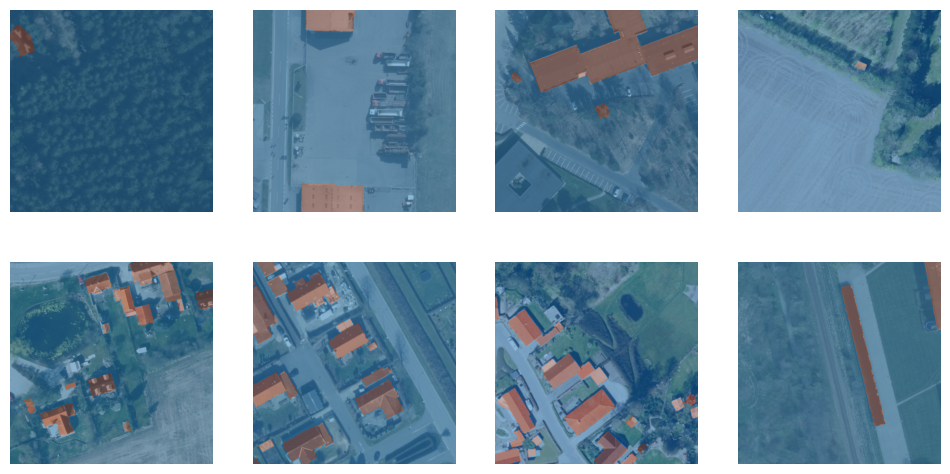

In [25]:
dls.show_batch(max_n=8)

# Create model

In [26]:
loss_func = CombinedCEFocalTverskyLoss()

In [27]:
opt = ranger

In [28]:
metrics = [Dice, iou]

In [29]:
learn = unet_learner(dls, models[model_idx], metrics=metrics, loss_func=loss_func,  
                     self_attention=True, act_cls=Mish, opt_func=opt).to_fp16() 

/home/alex/anaconda3/envs/mapai/lib/python3.10/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/home/alex/anaconda3/envs/mapai/lib/python3.10/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet34_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet34_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


# Load pretrained weights

In [29]:
#save_fn = f'stage-4_{model_name}_pretraining-{model_name}-{date.today()}'

In [32]:
save_fn = 'MapAI-500_resnet34-2022-11-22'

In [33]:
# Load pre-trained weights from Inria
learn.load(save_fn);

# Pseudo-labeling of mislabeled MapAI training patches

In [34]:
from utils import update_paths

In [35]:
learn.load(save_fn);

In [36]:
MAPAI_MASKS_BACKUP = MAPAI_MASKS/'backup'
MAPAI_MASKS_BACKUP.mkdir(exist_ok=True)

In [37]:
MAPAI_MASKS_BACKUP

Path('/home/alex/data/mapai/data/train/masks/backup')

In [38]:
mislabels_train = pd.read_csv(Path.cwd()/'..'/'csv'/'train_wrong_labeled.txt', header=None)

In [39]:
mislabels_train.head()

,0,1
0,../../data/train/images/6179_495_70.tif,NaN
1,../../data/train/images/6084_553_75.tif,NaN
2,../../data/train/images/6124_676_42.tif,NaN
3,../../data/train/images/6124_676_32.tif,NaN
4,../../data/train/images/6230_604_12.tif,NaN


In [40]:
mislabels_train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 231 entries, 0 to 230
Data columns (total 2 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   0       231 non-null    object 
 1   1       0 non-null      float64
dtypes: float64(1), object(1)
memory usage: 3.7+ KB


In [41]:
mislabels_train[0] = mislabels_train[0].apply(update_paths)

In [42]:
mislabels_train.head()

,0,1
0,/home/alex/data/mapai/data/train/images/6179_495_70.tif,NaN
1,/home/alex/data/mapai/data/train/images/6084_553_75.tif,NaN
2,/home/alex/data/mapai/data/train/images/6124_676_42.tif,NaN
3,/home/alex/data/mapai/data/train/images/6124_676_32.tif,NaN
4,/home/alex/data/mapai/data/train/images/6230_604_12.tif,NaN


In [43]:
def get_pred(fn):
    img = PILImage.create(fn)
    pred,_,probs = learn.predict(img)
    return img, pred

In [44]:
def save_new_mask(fn, scale=False, show=False):
    
    
    # Backup the old mask
    old_mask_path = fn.replace('images', 'masks')
    old_mask_fn = old_mask_path.split("/")[-1]
    
    backup_mask_path = MAPAI_MASKS_BACKUP/old_mask_fn
    shutil.copy(old_mask_path, backup_mask_path)
    
    # Create new mask
    
    _, pred = get_pred(fn)
        
    pred = Image.fromarray(((pred.numpy()).astype('uint8')))
    pred.save(old_mask_path)
    
    if show:
        img = Image.open(fn)
        orig_mask = Image.open(backup_mask_path)
        f, axs = plt.subplots(1,2)
        axs[0].imshow(img)
        axs[0].imshow(orig_mask, alpha=0.4)
        axs[0].set_title("Image and orig mask")
        axs[1].imshow(img)
        axs[1].imshow(pred, alpha=0.4)
        axs[1].set_title("Img and pred mask")
        plt.show()
    
    return pred

In [45]:
test = mislabels_train.iloc[0][0]
test

'/home/alex/data/mapai/data/train/images/6179_495_70.tif'

In [46]:
!ls $test

/home/alex/data/mapai/data/train/images/6179_495_70.tif


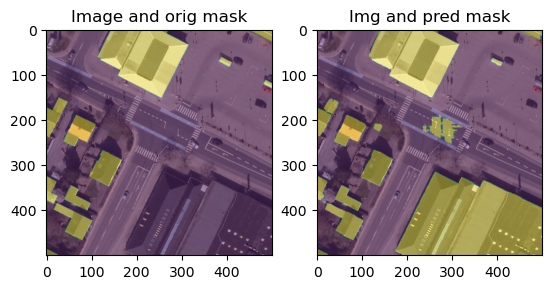

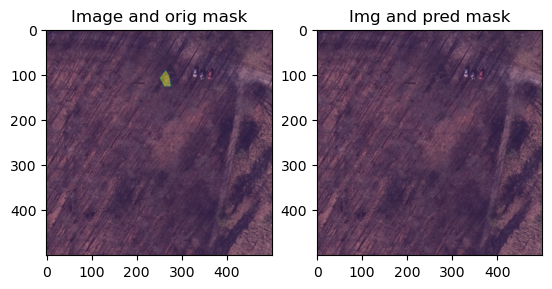

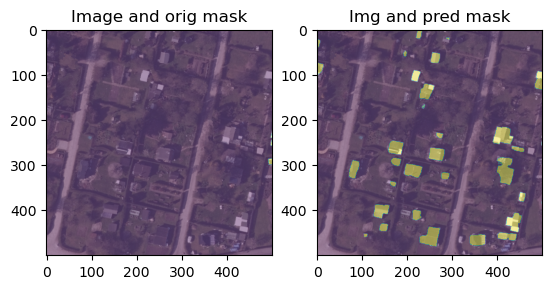

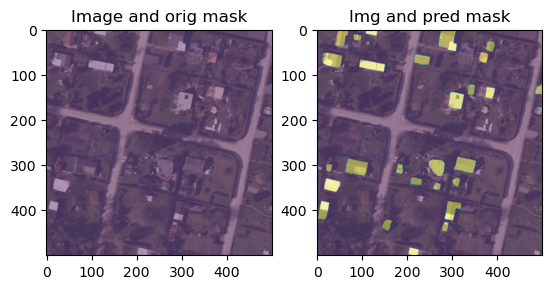

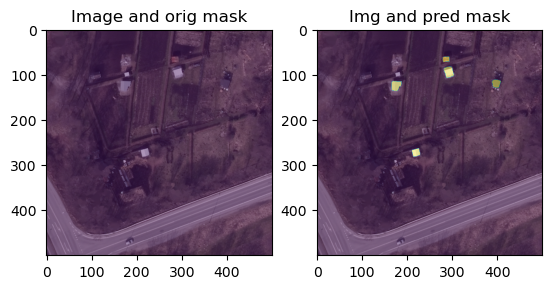

...

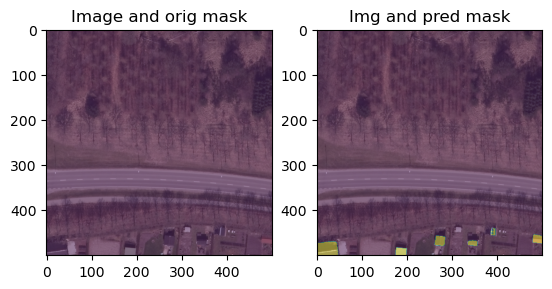

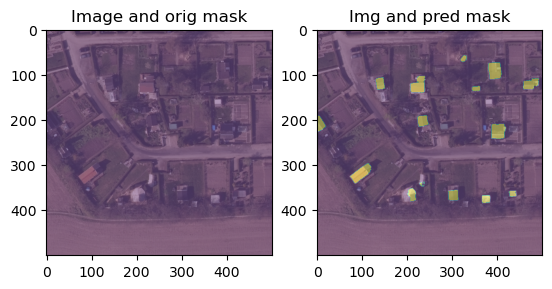

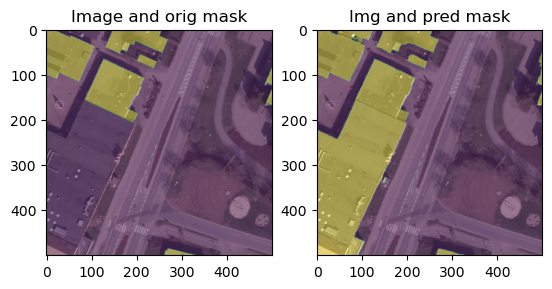

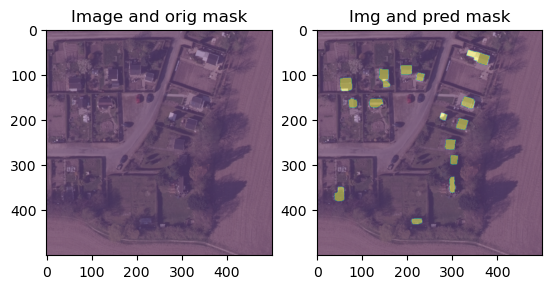

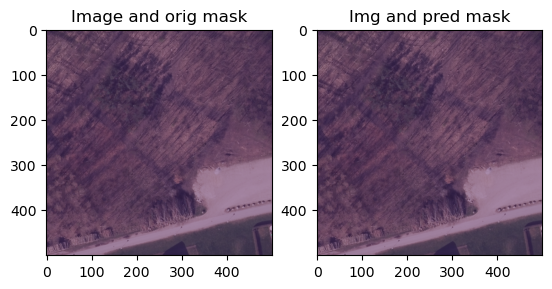

In [47]:
for img in mislabels_train[0]:
    save_new_mask(img, show=True)

# Stitch images

In [13]:
from utils import get_concat

In [14]:
?get_concat

In [15]:
def stitch_data(location, path, stitched_path, kind, 
                scale=False, verbose=False):
    fn_pattern = str(path)+"/" + f"{location}*"
    imgs = !ls -v $fn_pattern
    #print(imgs)
    df = pd.DataFrame(np.array(imgs).reshape(10,10))
    get_concat(df, f'{stitched_path}/{location}.tif', kind=kind, optimize=False, scale=scale)
    if verbose: print(f"stitched image saved at {f'{stitched_path}/{location}.tif'}")

In [51]:
stitch_data(locations[1], path=MAPAI_TRAIN/'images', stitched_path=STITCHED_TRAIN, kind='image', verbose=True)

stitched image saved at /home/alex/data/mapai/data/train/stitched_images/6226_569.tif


In [52]:
stitch_data(locations[1], path=MAPAI_TRAIN/'masks', kind='mask', 
            stitched_path=STITCHED_TRAIN_MASKS, verbose=True)

stitched image saved at /home/alex/data/mapai/data/train/stitched_masks/6226_569.tif


In [16]:
stitch_data(locations[1], path=MAPAI_TRAIN/'lidar', kind='lidar',
            stitched_path=STITCHED_TRAIN_LIDAR, verbose=True)

stitched image saved at /home/alex/data/mapai/data/train/stitched_lidar/6170_651.tif


In [17]:
for loc in locations:
    stitch_data(loc, path=MAPAI_TRAIN/'images', stitched_path=STITCHED_TRAIN)
    stitch_data(loc, path=MAPAI_TRAIN/'masks', kind='mask', stitched_path=STITCHED_TRAIN_MASKS)
    stitch_data(loc, path=MAPAI_TRAIN/'lidar', stitched_path=STITCHED_TRAIN_LIDAR, kind='lidar')

# Extract patches

In [18]:
(MAPAI_PATCHES/'images').mkdir(exist_ok=True)
(MAPAI_PATCHES/'masks').mkdir(exist_ok=True)
(MAPAI_PATCHES/'lidar').mkdir(exist_ok=True)

In [19]:
test_img_path = STITCHED_TRAIN/'6188_600.tif'
test_lidar_path = STITCHED_TRAIN_LIDAR/'6188_600.tif'
test_mask_path = STITCHED_TRAIN_MASKS/'6188_600.tif'

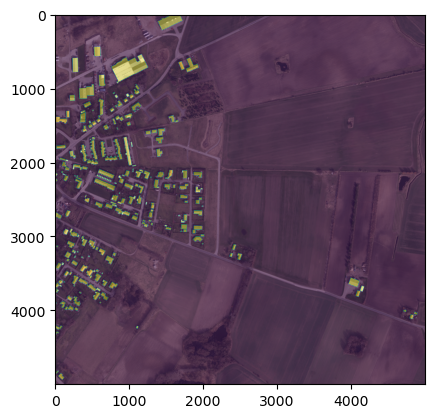

In [20]:
plt.imshow(Image.open(test_img_path))
plt.imshow(Image.open(test_mask_path), alpha=0.4)

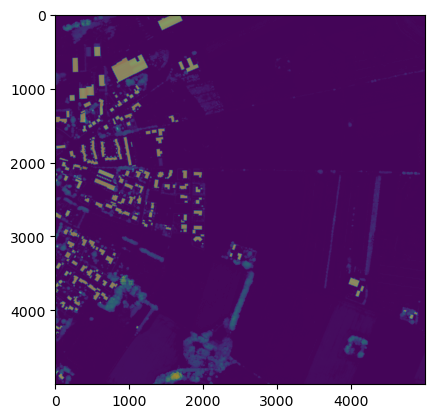

In [23]:
plt.imshow(np.array(Image.open(test_lidar_path)))
plt.imshow(Image.open(test_mask_path), alpha=0.4)

In [24]:
stitched_images = sorted(list(STITCHED_TRAIN.glob('*.tif')))
len(stitched_images), stitched_images[:5]

(70,
 [Path('/home/alex/data/mapai/data/train/stitched_images/6051_689.tif'),
  Path('/home/alex/data/mapai/data/train/stitched_images/6051_690.tif'),
  Path('/home/alex/data/mapai/data/train/stitched_images/6078_637.tif'),
  Path('/home/alex/data/mapai/data/train/stitched_images/6078_638.tif'),
  Path('/home/alex/data/mapai/data/train/stitched_images/6084_552.tif')])

In [25]:
stitched_lidar = sorted(list(STITCHED_TRAIN_LIDAR.glob('*.tif')))
len(stitched_lidar), stitched_lidar[:5]

(70,
 [Path('/home/alex/data/mapai/data/train/stitched_lidar/6051_689.tif'),
  Path('/home/alex/data/mapai/data/train/stitched_lidar/6051_690.tif'),
  Path('/home/alex/data/mapai/data/train/stitched_lidar/6078_637.tif'),
  Path('/home/alex/data/mapai/data/train/stitched_lidar/6078_638.tif'),
  Path('/home/alex/data/mapai/data/train/stitched_lidar/6084_552.tif')])

In [26]:
stitched_masks = sorted(list(STITCHED_TRAIN_MASKS.glob('*.tif')))
len(stitched_masks), stitched_masks[:5]

(70,
 [Path('/home/alex/data/mapai/data/train/stitched_masks/6051_689.tif'),
  Path('/home/alex/data/mapai/data/train/stitched_masks/6051_690.tif'),
  Path('/home/alex/data/mapai/data/train/stitched_masks/6078_637.tif'),
  Path('/home/alex/data/mapai/data/train/stitched_masks/6078_638.tif'),
  Path('/home/alex/data/mapai/data/train/stitched_masks/6084_552.tif')])

In [87]:
def get_random_patch(fn):
    
    mask_fn = str(fn).replace('stitched_images', 'stitched_masks')
    lidar_fn = str(fn).replace('stitched_images', 'stitched_lidar')
    
    img_a = np.array(Image.open(fn))
    lidar_a = np.array(Image.open(lidar_fn))
    mask_a = np.array(Image.open(mask_fn))
    
    r_nb_x = np.random.randint(0, 4500)
    r_nb_y = np.random.randint(0, 4500)
    
    img_a_patch = img_a[r_nb_x:(r_nb_x+500), r_nb_y:(r_nb_y+500)]
    lidar_a_patch = lidar_a[r_nb_x:(r_nb_x+500), r_nb_y:(r_nb_y+500)]
    mask_a_patch = mask_a[r_nb_x:(r_nb_x+500), r_nb_y:(r_nb_y+500)]
    
    img_patch = Image.fromarray(img_a_patch)
    lidar_patch = Image.fromarray(lidar_a_patch, mode='F')
    mask_patch = Image.fromarray(mask_a_patch, mode='L')
    
    return img_patch, lidar_patch, mask_patch

In [88]:
test_img_path

Path('/home/alex/data/mapai/data/train/stitched_images/6188_600.tif')

In [92]:
test_img, test_lidar, test_mask = get_random_patch(test_img_path)

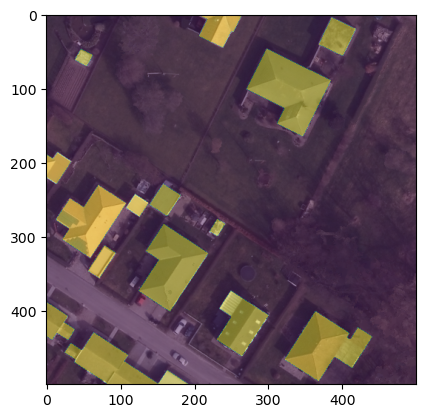

In [93]:
plt.imshow(test_img)
plt.imshow(test_mask, alpha=0.4)

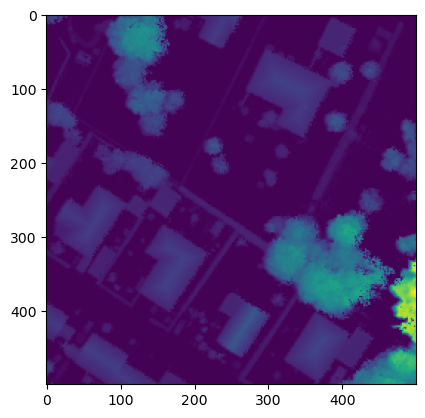

In [97]:
plt.imshow(np.array(test_lidar))

In [98]:
def create_patches(path, nb=500, save=True):
    path = str(path)
    for i in range(nb):
        img_savefn = str(MAPAI_PATCHES/'images'/f'{path.split("/")[-1].split(".")[0]}-{i}.tif')
        lidar_savefn = str(MAPAI_PATCHES/'lidar'/f'{path.split("/")[-1].split(".")[0]}-{i}.tif')
        mask_savefn = str(MAPAI_PATCHES/'masks'/f'{path.split("/")[-1].split(".")[0]}-{i}.tif')
      
        img_patch, lidar_patch, mask_patch = get_random_patch(path)
        img_patch.save(img_savefn)
        lidar_patch.save(lidar_savefn)
        mask_patch.save(mask_savefn)

In [102]:
# Test
create_patches(test_img_path, nb=2)

In [108]:
from multiprocessing import Pool
with Pool(16) as p:
    p.map(create_patches, stitched_images)

## Create CSV of img and mask patches

In [1]:
import pandas as pd
from datetime import date

In [ ]:
img_patches = sorted(list((MAPAI_PATCHES/'images').glob('*.tif')))
lidar_patches = sorted(list((MAPAI_PATCHES/'lidar').glob('*.tif')))
mask_patches = sorted(list((MAPAI_PATCHES/'masks').glob('*.tif')))

In [110]:
assert len(img_patches) == len(mask_patches)

In [111]:
patch_df = pd.DataFrame(data=zip(img_patches, lidar_patches, mask_patches), columns=['image', 'lidar', 'mask'])

In [112]:
patch_df.head()

,image,lidar,mask
0,/home/alex/data/mapai/data/train/patches/images/6051_689-0.tif,/home/alex/data/mapai/data/train/patches/lidar/6051_689-0.tif,/home/alex/data/mapai/data/train/patches/masks/6051_689-0.tif
1,/home/alex/data/mapai/data/train/patches/images/6051_689-1.tif,/home/alex/data/mapai/data/train/patches/lidar/6051_689-1.tif,/home/alex/data/mapai/data/train/patches/masks/6051_689-1.tif
2,/home/alex/data/mapai/data/train/patches/images/6051_689-10.tif,/home/alex/data/mapai/data/train/patches/lidar/6051_689-10.tif,/home/alex/data/mapai/data/train/patches/masks/6051_689-10.tif
3,/home/alex/data/mapai/data/train/patches/images/6051_689-100.tif,/home/alex/data/mapai/data/train/patches/lidar/6051_689-100.tif,/home/alex/data/mapai/data/train/patches/masks/6051_689-100.tif
4,/home/alex/data/mapai/data/train/patches/images/6051_689-101.tif,/home/alex/data/mapai/data/train/patches/lidar/6051_689-101.tif,/home/alex/data/mapai/data/train/patches/masks/6051_689-101.tif


In [113]:
patch_df['is_val'] = False

In [114]:
patch_df.to_csv(f'../csv/mapai_patches_{date.today()}.csv', index=None)

# Create CSV of patches together with original images

In [3]:
df = pd.read_csv(f'../csv/train_val_with_info-2022-11-24.csv')
df.shape

(8500, 7)

In [4]:
df.head()

,image,lidar,mask,is_val,mask_percentage,is_building,location
0,/home/alex/data/mapai/data/train/images/6179_4...,/home/alex/data/mapai/data/train/lidar/6179_49...,/home/alex/data/mapai/data/train/masks/6179_49...,False,0.155224,True,6179_495
1,/home/alex/data/mapai/data/train/images/6051_6...,/home/alex/data/mapai/data/train/lidar/6051_69...,/home/alex/data/mapai/data/train/masks/6051_69...,False,0.000000,False,6051_690
2,/home/alex/data/mapai/data/train/images/6121_8...,/home/alex/data/mapai/data/train/lidar/6121_86...,/home/alex/data/mapai/data/train/masks/6121_86...,False,0.017824,True,6121_865
3,/home/alex/data/mapai/data/train/images/6173_6...,/home/alex/data/mapai/data/train/lidar/6173_63...,/home/alex/data/mapai/data/train/masks/6173_63...,False,0.000000,False,6173_630
4,/home/alex/data/mapai/data/train/images/6147_4...,/home/alex/data/mapai/data/train/lidar/6147_48...,/home/alex/data/mapai/data/train/masks/6147_48...,False,0.182664,True,6147_481


In [5]:
df.is_val.value_counts()

False    7000
True     1500
Name: is_val, dtype: int64

In [6]:
patch_df = pd.read_csv(f'../csv/mapai_patches_2022-11-24.csv')
patch_df.head()

,image,lidar,mask,is_val
0,/home/alex/data/mapai/data/train/patches/image...,/home/alex/data/mapai/data/train/patches/lidar...,/home/alex/data/mapai/data/train/patches/masks...,False
1,/home/alex/data/mapai/data/train/patches/image...,/home/alex/data/mapai/data/train/patches/lidar...,/home/alex/data/mapai/data/train/patches/masks...,False
2,/home/alex/data/mapai/data/train/patches/image...,/home/alex/data/mapai/data/train/patches/lidar...,/home/alex/data/mapai/data/train/patches/masks...,False
3,/home/alex/data/mapai/data/train/patches/image...,/home/alex/data/mapai/data/train/patches/lidar...,/home/alex/data/mapai/data/train/patches/masks...,False
4,/home/alex/data/mapai/data/train/patches/image...,/home/alex/data/mapai/data/train/patches/lidar...,/home/alex/data/mapai/data/train/patches/masks...,False


In [7]:
df = pd.concat([df, patch_df])

In [8]:
df.head()

,image,lidar,mask,is_val,mask_percentage,is_building,location
0,/home/alex/data/mapai/data/train/images/6179_4...,/home/alex/data/mapai/data/train/lidar/6179_49...,/home/alex/data/mapai/data/train/masks/6179_49...,False,0.155224,True,6179_495
1,/home/alex/data/mapai/data/train/images/6051_6...,/home/alex/data/mapai/data/train/lidar/6051_69...,/home/alex/data/mapai/data/train/masks/6051_69...,False,0.000000,False,6051_690
2,/home/alex/data/mapai/data/train/images/6121_8...,/home/alex/data/mapai/data/train/lidar/6121_86...,/home/alex/data/mapai/data/train/masks/6121_86...,False,0.017824,True,6121_865
3,/home/alex/data/mapai/data/train/images/6173_6...,/home/alex/data/mapai/data/train/lidar/6173_63...,/home/alex/data/mapai/data/train/masks/6173_63...,False,0.000000,False,6173_630
4,/home/alex/data/mapai/data/train/images/6147_4...,/home/alex/data/mapai/data/train/lidar/6147_48...,/home/alex/data/mapai/data/train/masks/6147_48...,False,0.182664,True,6147_481


In [9]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 43500 entries, 0 to 34999
Data columns (total 7 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   image            43500 non-null  object 
 1   lidar            43500 non-null  object 
 2   mask             43500 non-null  object 
 3   is_val           43500 non-null  bool   
 4   mask_percentage  8500 non-null   float64
 5   is_building      8500 non-null   object 
 6   location         8500 non-null   object 
dtypes: bool(1), float64(1), object(5)
memory usage: 2.4+ MB


In [10]:
def fix_path(path):
    return str(path).replace("alex", "ubuntu")

In [11]:
df['image'] = df['image'].apply(fix_path)

In [12]:
df['lidar'] = df['lidar'].apply(fix_path)

In [13]:
df['mask'] = df['mask'].apply(fix_path)

In [14]:
df.head()

,image,lidar,mask,is_val,mask_percentage,is_building,location
0,/home/ubuntu/data/mapai/data/train/images/6179...,/home/ubuntu/data/mapai/data/train/lidar/6179_...,/home/ubuntu/data/mapai/data/train/masks/6179_...,False,0.155224,True,6179_495
1,/home/ubuntu/data/mapai/data/train/images/6051...,/home/ubuntu/data/mapai/data/train/lidar/6051_...,/home/ubuntu/data/mapai/data/train/masks/6051_...,False,0.000000,False,6051_690
2,/home/ubuntu/data/mapai/data/train/images/6121...,/home/ubuntu/data/mapai/data/train/lidar/6121_...,/home/ubuntu/data/mapai/data/train/masks/6121_...,False,0.017824,True,6121_865
3,/home/ubuntu/data/mapai/data/train/images/6173...,/home/ubuntu/data/mapai/data/train/lidar/6173_...,/home/ubuntu/data/mapai/data/train/masks/6173_...,False,0.000000,False,6173_630
4,/home/ubuntu/data/mapai/data/train/images/6147...,/home/ubuntu/data/mapai/data/train/lidar/6147_...,/home/ubuntu/data/mapai/data/train/masks/6147_...,False,0.182664,True,6147_481


In [15]:
df.to_csv(f'../csv/mapai_orig_and_fixed_patches_{date.today()}.csv', index=None)